# Importing and merging

In [1]:
import numpy as np
import pandas as pd
import sklearn as sk

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
county_data = pd.read_csv("/content/drive/MyDrive/county_statistics/county_statistics.csv")
county_data.drop("Unnamed: 0",axis=1,inplace=True)
county_data

,county,state,percentage16_Donald_Trump,percentage16_Hillary_Clinton,total_votes16,votes16_Donald_Trump,votes16_Hillary_Clinton,percentage20_Donald_Trump,percentage20_Joe_Biden,total_votes20,votes20_Donald_Trump,votes20_Joe_Biden,lat,long,cases,deaths,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,VotingAgeCitizen,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
0,Abbeville,SC,0.629,0.346,10724.0,6742.0,3712.0,0.661,0.330,12433.0,8215.0,4101.0,34.223334,-82.461707,805.0,17.0,24788.0,12044.0,12744.0,1.3,68.9,27.6,0.1,0.3,0.0,19452.0,35254.0,2259.0,19234.0,799.0,22.7,32.1,27.2,20.7,20.8,10.6,20.7,78.3,11.1,0.5,1.8,1.8,6.5,25.8,9505.0,78.8,13.3,7.8,0.1,9.4
1,Acadia,LA,0.773,0.206,27386.0,21159.0,5638.0,0.795,0.191,28425.0,22596.0,5443.0,30.295065,-92.414197,3182.0,102.0,62607.0,30433.0,32174.0,2.4,77.5,17.6,0.1,0.1,0.0,45197.0,40492.0,2544.0,21591.0,1002.0,21.5,27.6,27.6,16.9,25.7,15.0,14.8,83.2,10.3,0.2,1.6,2.2,2.5,27.6,24982.0,80.0,12.1,7.6,0.3,8.9
2,Accomack,VA,0.545,0.428,15755.0,8582.0,6737.0,0.542,0.447,16938.0,9172.0,7578.0,37.767072,-75.632346,1227.0,19.0,32840.0,16079.0,16761.0,8.8,60.3,28.3,0.3,0.7,0.0,24408.0,42260.0,2253.0,24266.0,1564.0,19.8,31.8,31.1,17.7,18.8,15.1,17.3,80.0,10.6,0.5,2.6,1.8,4.5,22.0,13837.0,74.6,18.1,7.1,0.2,5.4
3,Ada,ID,0.479,0.387,195587.0,93748.0,75676.0,0.504,0.465,259389.0,130699.0,120539.0,43.452658,-116.241552,17451.0,181.0,435117.0,217999.0,217118.0,7.9,85.2,1.2,0.4,2.6,0.1,316189.0,60151.0,1294.0,31642.0,725.0,11.8,13.1,43.0,16.6,25.0,6.9,8.4,80.7,7.7,0.5,1.5,2.8,6.9,20.4,214984.0,78.3,15.0,6.6,0.1,4.3
4,Adair,IA,0.653,0.300,3759.0,2456.0,1127.0,0.697,0.286,4183.0,2917.0,1197.0,41.330756,-94.471059,222.0,1.0,7192.0,3552.0,3640.0,1.7,96.6,0.3,0.0,0.4,0.0,5572.0,49477.0,2633.0,28861.0,2055.0,9.5,12.1,28.2,16.9,20.0,17.3,17.6,77.9,12.4,0.3,2.8,0.4,6.2,22.3,3680.0,73.8,15.3,10.4,0.5,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4862,Valdez-Cordova Census Area,AK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9439.0,4901.0,4538.0,4.8,70.2,0.1,13.3,2.8,0.6,7110.0,86019.0,5533.0,37935.0,3149.0,7.4,6.4,27.0,17.2,21.8,24.2,9.8,67.1,9.9,0.4,16.1,2.8,3.8,11.0,4755.0,56.9,34.6,7.8,0.7,7.5
4863,Wrangell City and Borough,AK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2475.0,1280.0,1195.0,3.2,64.4,0.2,20.6,3.1,0.0,1923.0,56094.0,5257.0,29943.0,2119.0,11.7,18.3,34.0,16.9,22.7,16.3,10.1,58.6,10.6,0.8,15.8,5.8,8.4,9.4,1095.0,52.5,32.3,12.5,2.6,7.0
4864,Yakutat City and Borough,AK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,682.0,366.0,316.0,5.6,43.7,0.9,28.3,5.4,1.3,522.0,64583.0,11434.0,32393.0,4250.0,6.2,10.1,24.9,18.6,23.6,21.0,11.9,48.7,14.3,0.8,26.9,5.0,4.2,6.5,377.0,45.6,44.0,10.3,0.0,6.5
4865,Yukon-Koyukuk Census Area,AK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5453.0,2936.0,2517.0,2.1,21.3,0.1,70.4,0.7,0.0,3900.0,37819.0,2854.0,21057.0,688.0,25.5,32.9,33.7,20.6,20.0,15.0,10.7,25.7,7.1,0.3,39.8,19.2,8.0,8.4,2082.0,38.8,56.5,4.7,0.0,19.7


In [6]:
nyt_counties = pd.read_csv("/content/drive/MyDrive/us-counties-recent.csv")
nyt_counties = nyt_counties.groupby(by=['state','county','fips']).size().reset_index().drop(0, axis=1)
#nyt_counties['fips'] = nyt_counties['fips'].apply(lambda x: str(int(x)).zfill(5))
nyt_counties

,state,county,fips
0,Alabama,Autauga,1001.0
1,Alabama,Baldwin,1003.0
2,Alabama,Barbour,1005.0
3,Alabama,Bibb,1007.0
4,Alabama,Blount,1009.0
...,...,...,...
3213,Wyoming,Sweetwater,56037.0
3214,Wyoming,Teton,56039.0
3215,Wyoming,Uinta,56041.0
3216,Wyoming,Washakie,56043.0


In [8]:
mask_use = pd.read_csv("/content/drive/MyDrive/mask-use-by-county.csv")
#mask_use['COUNTYFP'] = mask_use['COUNTYFP'].apply(lambda x: str(int(x)).zfill(5))
mask_use.set_index('COUNTYFP', inplace=True)
mask_use

,NEVER,RARELY,SOMETIMES,FREQUENTLY,ALWAYS
COUNTYFP,,,,,
1001,0.053,0.074,0.134,0.295,0.444
1003,0.083,0.059,0.098,0.323,0.436
1005,0.067,0.121,0.120,0.201,0.491
1007,0.020,0.034,0.096,0.278,0.572
1009,0.053,0.114,0.180,0.194,0.459
...,...,...,...,...,...
56037,0.061,0.295,0.230,0.146,0.268
56039,0.095,0.157,0.160,0.247,0.340
56041,0.098,0.278,0.154,0.207,0.264


In [10]:
state_abbrev = pd.read_csv("/content/drive/MyDrive/state_abbreviations.csv")
state_abbrev.drop('Abbrev', axis=1, inplace=True)
state_abbrev.columns = ['state', 'code']
state_abbrev

,state,code
0,Alabama,AL
1,Alaska,AK
2,Arizona,AZ
3,Arkansas,AR
4,California,CA
5,Colorado,CO
6,Connecticut,CT
7,Delaware,DE
8,District of Columbia,DC
9,Florida,FL


In [11]:
state_county_fips = nyt_counties.join(state_abbrev.set_index('state'),on='state',lsuffix="_left")
state_county_fips.drop('state',axis=1,inplace=True)
state_county_fips.columns=['county','fips','state']
state_county_fips

,county,fips,state
0,Autauga,1001.0,AL
1,Baldwin,1003.0,AL
2,Barbour,1005.0,AL
3,Bibb,1007.0,AL
4,Blount,1009.0,AL
...,...,...,...
3213,Sweetwater,56037.0,WY
3214,Teton,56039.0,WY
3215,Uinta,56041.0,WY
3216,Washakie,56043.0,WY


In [12]:
county_data_merged = state_county_fips.merge(county_data,left_on=['county','state'],right_on=['county','state'])
county_data_merged.set_index('fips',inplace=True)

county_data_merged.drop(['county','state'],axis=1,inplace=True)
county_data_merged.drop(['cases','deaths'],axis=1,inplace=True)
county_data_merged.drop('VotingAgeCitizen',axis=1,inplace=True)
county_data_merged.drop(['total_votes16','votes16_Donald_Trump','votes16_Hillary_Clinton','total_votes20','votes20_Donald_Trump', 'votes20_Joe_Biden'],axis=1,inplace=True)
#county_data_merged.drop(['Drive','Carpool','Transit','Walk','OtherTransp','WorkAtHome','MeanCommute'],axis=1,inplace=True)
#county_data_merged.drop(['Employed','PrivateWork','PublicWork','SelfEmployed','FamilyWork','Professional','Service','Office','Construction','Production'],axis=1,inplace=True)

county_data_merged

,percentage16_Donald_Trump,percentage16_Hillary_Clinton,percentage20_Donald_Trump,percentage20_Joe_Biden,lat,long,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
fips,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1001.0,0.734,0.240,0.715,0.270,32.539527,-86.644082,55036.0,26899.0,28137.0,2.7,75.4,18.9,0.3,0.9,0.0,55317.0,2838.0,27824.0,2024.0,13.7,20.1,35.3,18.0,23.2,8.1,15.4,86.0,9.6,0.1,0.6,1.3,2.5,25.8,24112.0,74.1,20.2,5.6,0.1,5.2
1003.0,0.774,0.196,0.762,0.223,30.727750,-87.722071,203360.0,99527.0,103833.0,4.4,83.1,9.5,0.8,0.7,0.0,52562.0,1348.0,29364.0,735.0,11.8,16.1,35.7,18.2,25.6,9.7,10.8,84.7,7.6,0.1,0.8,1.1,5.6,27.0,89527.0,80.7,12.9,6.3,0.1,5.5
1005.0,0.523,0.467,0.536,0.456,31.868263,-85.387129,26201.0,13976.0,12225.0,4.2,45.7,47.8,0.2,0.6,0.0,33368.0,2551.0,17561.0,798.0,27.2,44.9,25.0,16.8,22.6,11.5,24.1,83.4,11.1,0.3,2.2,1.7,1.3,23.4,8878.0,74.1,19.1,6.5,0.3,12.4
1007.0,0.770,0.214,0.784,0.207,32.996421,-87.125115,22580.0,12251.0,10329.0,2.4,74.6,22.0,0.4,0.0,0.0,43404.0,3431.0,20911.0,1889.0,15.2,26.6,24.4,17.6,19.7,15.9,22.4,86.4,9.5,0.7,0.3,1.7,1.5,30.0,8171.0,76.0,17.4,6.3,0.3,8.2
1009.0,0.899,0.085,0.896,0.096,33.982109,-86.567906,57667.0,28490.0,29177.0,9.0,87.4,1.5,0.3,0.1,0.0,47412.0,2630.0,22021.0,850.0,15.6,25.4,28.5,12.9,23.3,15.8,19.5,86.8,10.2,0.1,0.4,0.4,2.1,35.0,21380.0,83.9,11.9,4.0,0.1,4.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56037.0,0.729,0.194,0.737,0.230,41.659439,-108.882788,44527.0,22981.0,21546.0,16.0,79.6,0.8,0.6,0.6,0.5,71083.0,4336.0,31700.0,1368.0,12.0,15.7,27.7,16.1,20.0,20.8,15.4,77.5,14.4,2.6,2.8,1.3,1.5,20.5,22739.0,78.4,17.8,3.8,0.0,5.2
56039.0,0.322,0.601,0.296,0.671,43.935225,-110.589080,22923.0,12169.0,10754.0,15.0,81.5,0.5,0.3,2.2,0.0,80049.0,4586.0,49200.0,4567.0,6.8,2.8,39.4,25.4,17.0,11.7,6.5,68.3,6.7,3.8,11.7,3.8,5.7,14.3,14492.0,82.1,11.4,6.5,0.0,1.3
56041.0,0.764,0.149,0.797,0.169,41.287818,-110.547578,20758.0,10593.0,10165.0,9.1,87.7,0.1,0.9,0.1,0.0,54672.0,7803.0,27115.0,2401.0,14.9,20.0,30.4,19.4,18.1,16.1,16.1,77.4,14.9,3.3,1.1,1.3,2.0,19.9,9528.0,71.5,21.5,6.6,0.4,6.4


In [13]:
county_data_merged.dropna(inplace=True)
mask_use = mask_use.loc[county_data_merged.index]
county_data_merged

,percentage16_Donald_Trump,percentage16_Hillary_Clinton,percentage20_Donald_Trump,percentage20_Joe_Biden,lat,long,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
fips,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1001.0,0.734,0.240,0.715,0.270,32.539527,-86.644082,55036.0,26899.0,28137.0,2.7,75.4,18.9,0.3,0.9,0.0,55317.0,2838.0,27824.0,2024.0,13.7,20.1,35.3,18.0,23.2,8.1,15.4,86.0,9.6,0.1,0.6,1.3,2.5,25.8,24112.0,74.1,20.2,5.6,0.1,5.2
1003.0,0.774,0.196,0.762,0.223,30.727750,-87.722071,203360.0,99527.0,103833.0,4.4,83.1,9.5,0.8,0.7,0.0,52562.0,1348.0,29364.0,735.0,11.8,16.1,35.7,18.2,25.6,9.7,10.8,84.7,7.6,0.1,0.8,1.1,5.6,27.0,89527.0,80.7,12.9,6.3,0.1,5.5
1005.0,0.523,0.467,0.536,0.456,31.868263,-85.387129,26201.0,13976.0,12225.0,4.2,45.7,47.8,0.2,0.6,0.0,33368.0,2551.0,17561.0,798.0,27.2,44.9,25.0,16.8,22.6,11.5,24.1,83.4,11.1,0.3,2.2,1.7,1.3,23.4,8878.0,74.1,19.1,6.5,0.3,12.4
1007.0,0.770,0.214,0.784,0.207,32.996421,-87.125115,22580.0,12251.0,10329.0,2.4,74.6,22.0,0.4,0.0,0.0,43404.0,3431.0,20911.0,1889.0,15.2,26.6,24.4,17.6,19.7,15.9,22.4,86.4,9.5,0.7,0.3,1.7,1.5,30.0,8171.0,76.0,17.4,6.3,0.3,8.2
1009.0,0.899,0.085,0.896,0.096,33.982109,-86.567906,57667.0,28490.0,29177.0,9.0,87.4,1.5,0.3,0.1,0.0,47412.0,2630.0,22021.0,850.0,15.6,25.4,28.5,12.9,23.3,15.8,19.5,86.8,10.2,0.1,0.4,0.4,2.1,35.0,21380.0,83.9,11.9,4.0,0.1,4.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56037.0,0.729,0.194,0.737,0.230,41.659439,-108.882788,44527.0,22981.0,21546.0,16.0,79.6,0.8,0.6,0.6,0.5,71083.0,4336.0,31700.0,1368.0,12.0,15.7,27.7,16.1,20.0,20.8,15.4,77.5,14.4,2.6,2.8,1.3,1.5,20.5,22739.0,78.4,17.8,3.8,0.0,5.2
56039.0,0.322,0.601,0.296,0.671,43.935225,-110.589080,22923.0,12169.0,10754.0,15.0,81.5,0.5,0.3,2.2,0.0,80049.0,4586.0,49200.0,4567.0,6.8,2.8,39.4,25.4,17.0,11.7,6.5,68.3,6.7,3.8,11.7,3.8,5.7,14.3,14492.0,82.1,11.4,6.5,0.0,1.3
56041.0,0.764,0.149,0.797,0.169,41.287818,-110.547578,20758.0,10593.0,10165.0,9.1,87.7,0.1,0.9,0.1,0.0,54672.0,7803.0,27115.0,2401.0,14.9,20.0,30.4,19.4,18.1,16.1,16.1,77.4,14.9,3.3,1.1,1.3,2.0,19.9,9528.0,71.5,21.5,6.6,0.4,6.4


In [14]:
county_data_merged['DemMargin20'] = county_data_merged['percentage20_Joe_Biden'] - county_data_merged['percentage20_Donald_Trump']
county_data_merged['DemMargin16'] = county_data_merged['percentage16_Hillary_Clinton'] - county_data_merged['percentage16_Donald_Trump']
county_data_merged['MarginShift'] = county_data_merged['DemMargin20'] - county_data_merged['DemMargin16']
county_data_merged.drop(['percentage20_Joe_Biden', 'percentage20_Donald_Trump', 'percentage16_Donald_Trump', 'percentage16_Hillary_Clinton'], axis=1, inplace=True) 

county_data_merged['PctMale'] = county_data_merged['Men'] / county_data_merged['TotalPop']
county_data_merged['PctFemale'] = county_data_merged['Women'] / county_data_merged['TotalPop']
county_data_merged['GenderBiasMale'] = county_data_merged['PctMale'] - county_data_merged['PctFemale']
county_merged_copy = county_data_merged.copy()
county_data_merged.drop(['Men','Women', 'PctMale', 'PctFemale'],axis=1,inplace=True)

county_data_merged['lat'] = county_data_merged['lat'] / county_data_merged['lat'].mean() - 1
county_data_merged['long'] = county_data_merged['long'] / county_data_merged['long'].mean() - 1
county_data_merged

,lat,long,TotalPop,Hispanic,White,Black,Native,Asian,Pacific,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,DemMargin20,DemMargin16,MarginShift,GenderBiasMale
fips,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1001.0,-0.148804,-0.059170,55036.0,2.7,75.4,18.9,0.3,0.9,0.0,55317.0,2838.0,27824.0,2024.0,13.7,20.1,35.3,18.0,23.2,8.1,15.4,86.0,9.6,0.1,0.6,1.3,2.5,25.8,24112.0,74.1,20.2,5.6,0.1,5.2,-0.445,-0.494,0.049,-0.022494
1003.0,-0.196198,-0.047464,203360.0,4.4,83.1,9.5,0.8,0.7,0.0,52562.0,1348.0,29364.0,735.0,11.8,16.1,35.7,18.2,25.6,9.7,10.8,84.7,7.6,0.1,0.8,1.1,5.6,27.0,89527.0,80.7,12.9,6.3,0.1,5.5,-0.539,-0.578,0.039,-0.021174
1005.0,-0.166363,-0.072818,26201.0,4.2,45.7,47.8,0.2,0.6,0.0,33368.0,2551.0,17561.0,798.0,27.2,44.9,25.0,16.8,22.6,11.5,24.1,83.4,11.1,0.3,2.2,1.7,1.3,23.4,8878.0,74.1,19.1,6.5,0.3,12.4,-0.080,-0.056,-0.024,0.066830
1007.0,-0.136852,-0.053946,22580.0,2.4,74.6,22.0,0.4,0.0,0.0,43404.0,3431.0,20911.0,1889.0,15.2,26.6,24.4,17.6,19.7,15.9,22.4,86.4,9.5,0.7,0.3,1.7,1.5,30.0,8171.0,76.0,17.4,6.3,0.3,8.2,-0.577,-0.556,-0.021,0.085120
1009.0,-0.111068,-0.059997,57667.0,9.0,87.4,1.5,0.3,0.1,0.0,47412.0,2630.0,22021.0,850.0,15.6,25.4,28.5,12.9,23.3,15.8,19.5,86.8,10.2,0.1,0.4,0.4,2.1,35.0,21380.0,83.9,11.9,4.0,0.1,4.9,-0.800,-0.814,0.014,-0.011913
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56037.0,0.089762,0.182311,44527.0,16.0,79.6,0.8,0.6,0.6,0.5,71083.0,4336.0,31700.0,1368.0,12.0,15.7,27.7,16.1,20.0,20.8,15.4,77.5,14.4,2.6,2.8,1.3,1.5,20.5,22739.0,78.4,17.8,3.8,0.0,5.2,-0.507,-0.535,0.028,0.032228
56039.0,0.149294,0.200839,22923.0,15.0,81.5,0.5,0.3,2.2,0.0,80049.0,4586.0,49200.0,4567.0,6.8,2.8,39.4,25.4,17.0,11.7,6.5,68.3,6.7,3.8,11.7,3.8,5.7,14.3,14492.0,82.1,11.4,6.5,0.0,1.3,0.375,0.279,0.096,0.061728
56041.0,0.080041,0.200388,20758.0,9.1,87.7,0.1,0.9,0.1,0.0,54672.0,7803.0,27115.0,2401.0,14.9,20.0,30.4,19.4,18.1,16.1,16.1,77.4,14.9,3.3,1.1,1.3,2.0,19.9,9528.0,71.5,21.5,6.6,0.4,6.4,-0.628,-0.615,-0.013,0.020619


In [15]:
mask_use_single = mask_use.dot([0, 0.25, 0.5, 0.75, 1])
mask_use_single

fips
1001.0     0.75075
1003.0     0.74200
1005.0     0.73200
1007.0     0.83700
1009.0     0.72300
            ...   
56037.0    0.56625
56039.0    0.64450
56041.0    0.56575
56043.0    0.57400
56045.0    0.63550
Length: 3041, dtype: float64

# Exploratory analysis

In [16]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler().fit(county_data_merged)

scaled_df = county_data_merged.copy()
scaled_df_index = scaled_df.index
scaled_df_columns = scaled_df.columns

scaled_df = pd.DataFrame(scaler.transform(scaled_df))
scaled_df.index = scaled_df_index
scaled_df.columns = scaled_df_columns

scaled_df[['lat','long']] = county_data_merged[['lat', 'long']]

scaled_df

,lat,long,TotalPop,Hispanic,White,Black,Native,Asian,Pacific,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,DemMargin20,DemMargin16,MarginShift,GenderBiasMale
fips,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1001.0,-0.148804,-0.059170,-0.138119,-0.468596,-0.096093,0.707158,-0.196531,-0.128441,-0.182058,0.453620,-0.134427,0.317599,0.429624,-0.351932,-0.197529,0.607507,-0.019017,0.470157,-1.120992,-0.110814,0.961015,-0.107444,-0.332866,-0.855854,-0.188778,-0.744437,0.432127,-0.145442,-0.151335,0.593125,-0.571055,-0.406731,-0.374462,-0.366417,-0.549112,0.822422,-0.509922
1003.0,-0.196198,-0.047464,0.320017,-0.345448,0.295634,0.050277,-0.116948,-0.209350,-0.182058,0.239233,-0.759109,0.571507,-0.685629,-0.644403,-0.586724,0.669963,0.035851,1.261513,-0.731896,-0.908492,0.753209,-0.799461,-0.332866,-0.783938,-0.364068,0.255731,0.651875,0.275912,0.748925,-0.641980,-0.390393,-0.406731,-0.273519,-0.669910,-0.830307,0.659709,-0.482158
1005.0,-0.166363,-0.072818,-0.227183,-0.359936,-1.607041,2.726718,-0.212448,-0.249805,-0.182058,-1.254400,-0.254752,-1.374516,-0.631121,1.726147,2.215484,-1.000732,-0.348223,0.272318,-0.294164,1.397839,0.545402,0.411569,-0.237766,-0.280523,0.161801,-1.131598,-0.007371,-0.243568,-0.151335,0.407014,-0.338775,0.033828,2.048175,0.812039,0.917119,-0.365385,1.368729
1007.0,-0.136852,-0.053946,-0.238368,-0.490328,-0.136792,0.923789,-0.180615,-0.492533,-0.182058,-0.473422,0.114187,-0.822183,0.312821,-0.121035,0.434914,-1.094415,-0.128752,-0.683903,0.775847,1.103045,1.024955,-0.142044,-0.047566,-0.963728,0.161801,-1.067071,1.201247,-0.248122,0.107831,0.119386,-0.390393,0.033828,0.634970,-0.792598,-0.756661,-0.316571,1.753404
1009.0,-0.111068,-0.059997,-0.129993,-0.012223,0.514391,-0.508771,-0.196531,-0.452078,-0.182058,-0.161529,-0.221631,-0.639172,-0.586130,-0.059462,0.318156,-0.454243,-1.418145,0.503130,0.751529,0.600160,1.088896,0.100162,-0.332866,-0.927770,-0.977582,-0.873491,2.116867,-0.163039,1.185415,-0.811173,-0.983997,-0.406731,-0.475406,-1.512586,-1.620331,0.252925,-0.287380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56037.0,0.089762,0.182311,-0.170579,0.494859,0.117577,-0.557687,-0.148782,-0.249805,1.093018,1.680494,0.493608,0.956656,-0.137952,-0.613617,-0.625644,-0.579155,-0.540261,-0.584983,1.967451,-0.110814,-0.397720,1.553398,0.855886,-0.064774,-0.188778,-1.067071,-0.538430,-0.154286,0.435198,0.187063,-1.035615,-0.627010,-0.374462,-0.566593,-0.686362,0.480724,0.640986
56039.0,0.149294,0.200839,-0.237308,0.422419,0.214237,-0.578652,-0.196531,0.397469,-0.182058,2.378208,0.598421,3.841973,2.629848,-1.414062,-1.880800,1.247680,2.011090,-1.574177,-0.245528,-1.654148,-1.868350,-1.110869,1.426487,3.135502,2.002343,0.287995,-1.673798,-0.207407,0.939890,-0.895769,-0.338775,-0.627010,-1.686724,2.281073,2.038551,1.587174,1.261443
56041.0,0.080041,0.200388,-0.243996,-0.004979,0.529653,-0.606604,-0.101032,-0.452078,-0.182058,0.403428,1.947146,0.200703,0.755807,-0.167214,-0.207259,-0.157577,0.365057,-1.211473,0.824484,0.010572,-0.413705,1.726403,1.188737,-0.676063,-0.188778,-0.905754,-0.648304,-0.239381,-0.505983,0.813076,-0.312966,0.254107,0.029310,-0.957259,-0.954166,-0.186401,0.396825


In [17]:
corr_df = scaled_df.join(mask_use)

corr_df = corr_df.corr()
corr_df = corr_df.drop(scaled_df.columns).drop(mask_use.columns, axis=1)
corr_df

,lat,long,TotalPop,Hispanic,White,Black,Native,Asian,Pacific,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,DemMargin20,DemMargin16,MarginShift,GenderBiasMale
NEVER,0.190247,0.113574,-0.197338,-0.214434,0.252203,-0.135849,0.100373,-0.228180,-0.046764,-0.212851,0.155650,-0.175111,0.181922,0.049059,0.027316,-0.128838,-0.134096,-0.198234,0.198021,0.191061,-0.035316,0.003470,-0.200744,0.138122,-0.092815,0.114784,-0.249100,-0.197879,-0.150368,-0.017150,0.293087,0.153073,-0.152838,-0.395350,-0.378437,-0.152985,0.026716
RARELY,0.240245,0.163475,-0.211782,-0.224135,0.311092,-0.195652,0.073931,-0.243092,-0.053165,-0.147861,0.159051,-0.124906,0.182125,-0.036160,-0.042642,-0.110050,-0.148207,-0.203433,0.180204,0.194936,-0.023437,0.006696,-0.206274,0.122976,-0.107043,0.110552,-0.251879,-0.211000,-0.104537,-0.038609,0.240043,0.144333,-0.189680,-0.411198,-0.398565,-0.135018,0.050328
SOMETIMES,0.096427,0.023900,-0.207722,-0.222403,0.234731,-0.081136,0.048397,-0.241228,-0.064324,-0.213635,0.099059,-0.214265,0.107843,0.020546,0.009800,-0.197939,-0.103110,-0.132530,0.126260,0.264852,0.089235,-0.023007,-0.209687,0.021432,-0.087299,-0.002780,-0.191015,-0.208491,-0.053338,-0.031318,0.140138,0.073805,-0.092192,-0.355041,-0.333093,-0.170241,0.048083
FREQUENTLY,0.151288,0.081855,-0.145002,-0.204960,0.222818,-0.102336,0.054046,-0.151403,-0.045686,-0.013415,0.095956,-0.018318,0.084958,-0.092511,-0.106279,0.003897,-0.121956,-0.095579,0.060096,0.080188,-0.009019,-0.029523,-0.127287,0.087021,-0.045223,0.070682,-0.146317,-0.141586,-0.017818,-0.041764,0.091526,0.054428,-0.147521,-0.225315,-0.239842,0.030273,0.063819
ALWAYS,-0.261029,-0.146935,0.293202,0.334600,-0.393203,0.197553,-0.106803,0.332092,0.080932,0.224041,-0.195963,0.203277,-0.213527,0.024223,0.044825,0.164396,0.196095,0.241495,-0.215911,-0.279911,-0.008014,0.017143,0.285943,-0.142752,0.127107,-0.113093,0.322242,0.292030,0.124429,0.049990,-0.293054,-0.163004,0.224766,0.532629,0.518994,0.161628,-0.073363


In [18]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression().fit(scaled_df,mask_use)
df = pd.DataFrame(lr.coef_)
df.columns = scaled_df.columns
df.index = mask_use.columns

for x in df.index:
    print(df.loc[x].sort_values(ascending=False,key=abs).head(10))
    print()

lat             0.086787
Production      0.041607
Professional    0.041408
Construction    0.027030
long            0.026357
Service         0.023137
Office          0.019347
PrivateWork    -0.018251
PublicWork     -0.017943
Drive          -0.017092
Name: NEVER, dtype: float64

Professional    0.233299
Production      0.212952
Construction    0.147719
Service         0.131401
Office          0.107858
lat             0.075587
long            0.074348
PrivateWork    -0.063526
PublicWork     -0.054304
SelfEmployed   -0.033233
Name: RARELY, dtype: float64

Drive           0.113481
PrivateWork    -0.111547
PublicWork     -0.091114
WorkAtHome      0.056144
SelfEmployed   -0.056101
Production      0.052535
Carpool         0.050257
Professional    0.048812
Walk            0.046284
Transit         0.040396
Name: SOMETIMES, dtype: float64

PrivateWork     0.147932
PublicWork      0.113016
Drive          -0.078509
SelfEmployed    0.073011
long            0.068496
TotalPop       -0.039338
Employed

# Model

In [19]:
from sklearn.decomposition import PCA
pca = PCA(svd_solver='full')
pca.fit(scaled_df)
pca_df = pd.DataFrame(pca.transform(scaled_df))
pca_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36
0,0.430570,0.713170,-1.075494,-1.165633,-1.364890,-0.316192,0.507382,0.261351,-0.094701,0.241111,0.363858,-0.257240,0.879741,-0.197821,0.117784,-0.377680,0.022147,-0.631843,0.561779,-0.489855,0.179367,-0.372461,-0.189211,-0.033273,0.627483,-0.203485,0.017874,0.021713,-0.117635,-0.001520,0.040554,-0.013190,0.006372,-0.011895,-0.000614,0.000034,-3.478632e-16
1,1.527404,0.749580,-1.846822,-1.001985,-0.484141,0.620174,1.005844,-0.192447,-0.644803,0.089171,0.871496,0.261707,-0.309626,0.167557,-0.235779,-0.027105,0.065274,0.262011,-0.000065,-0.155150,-0.157812,-0.266427,-0.737314,-0.318126,0.608676,-0.185332,-0.221568,-0.255764,0.247348,0.010338,0.091478,-0.033761,0.020116,0.012882,-0.000140,0.000436,-1.118612e-16
2,-3.858645,3.184073,1.062866,-0.194247,0.260945,-1.501131,-0.151774,0.171874,0.536807,0.320731,-0.231048,0.721536,0.277152,-1.564090,0.263141,-0.612665,-1.054176,0.724808,-0.241493,0.220928,0.017844,0.607026,-0.218160,0.466512,-0.267353,-0.370623,0.492435,-0.238436,-0.093714,-0.009269,0.046865,-0.004317,-0.004674,0.000195,0.000070,0.000141,-7.345149e-17
3,-2.398340,0.325830,-1.339382,0.779386,-0.880299,-0.707925,0.259173,0.868306,-0.352642,1.428878,-0.800659,0.360341,-0.517285,-1.234349,0.185396,0.054881,0.090478,0.019812,-0.148070,-0.483219,-0.113012,0.429778,-0.043317,0.191766,0.179032,-0.229805,-0.156172,-0.230167,-0.233221,-0.012686,0.054807,-0.039751,0.000285,-0.011618,-0.000525,0.000568,-1.416860e-16
4,-0.936152,0.391880,-3.582405,0.857598,-0.456357,0.286459,1.395107,1.223800,-0.643884,-0.250629,0.084094,-0.257331,-0.306744,-0.037280,0.572467,-0.136356,0.503313,0.734897,-0.458975,0.364150,0.095172,-1.021871,0.210911,-0.067989,0.438739,-0.333482,-0.335676,-0.202684,-0.107718,-0.048502,0.006956,-0.004980,0.014662,0.001230,-0.000630,0.010226,1.621186e-17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3036,0.683115,-0.902282,-0.688162,2.089336,-1.467465,0.878147,-1.030872,1.156451,-0.369961,-0.495881,-0.577038,-0.594006,1.025632,-0.223382,0.935109,-0.063863,0.824922,0.428382,-1.049290,-0.430330,-0.428928,0.786392,0.230471,-0.612657,-0.299540,-0.093457,1.218064,0.349702,0.126338,-0.082574,-0.012111,-0.019654,0.003218,-0.010884,0.000093,-0.000958,1.538939e-16
3037,5.743000,-1.960893,2.816250,-0.218379,-0.747122,-1.643938,-4.550525,-2.005331,-0.788657,0.888027,-0.835555,-0.086844,0.743293,0.053969,0.218230,1.940359,1.440793,0.189177,-0.061246,-0.612707,-1.529479,0.219428,1.075463,0.490716,0.755707,-0.327503,0.636840,0.131940,0.609507,-0.061844,0.110792,-0.045790,0.030910,0.000807,0.000965,-0.000384,-6.072389e-16
3038,-0.816944,-1.858238,0.143530,1.354957,-1.003024,-0.030647,-0.299234,0.876900,-0.750386,0.301785,-0.886586,-0.676432,1.328863,0.565516,1.033837,-0.407968,0.580906,-0.485923,0.785522,-0.764181,-0.325091,0.465381,-0.374921,-0.764681,-1.168973,-0.024760,0.312889,0.134184,-0.062578,-0.169443,0.012047,0.006435,0.015540,-0.000718,0.009706,0.000467,-7.556167e-17
3039,-0.363982,-2.499657,0.205697,0.284657,-0.090155,0.744837,-0.207049,-0.656507,0.164694,-0.302684,-0.751432,-0.841801,0.749065,-0.122274,0.100924,-0.975482,0.990532,0.010861,-0.826011,0.527291,-0.045229,1.057010,0.059276,-0.075133,0.788048,0.257822,0.665294,-0.106955,0.063841,-0.100086,-0.052309,0.036868,-0.007275,0.000670,0.009483,-0.008986,-1.170129e-16


In [20]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split

X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(pca_df, mask_use, random_state=1)
pca_model = MLPRegressor(hidden_layer_sizes=(512,512,512,512)).fit(X_train_pca,y_train_pca)

In [21]:
X_train, X_test, y_train, y_test = train_test_split(scaled_df, mask_use, random_state=1)
non_pca_model = MLPRegressor(hidden_layer_sizes=(512,512,512,512)).fit(X_train,y_train)

In [22]:
test_predictions = pd.DataFrame(pca_model.predict(X_test_pca))
test_predictions.columns = y_test.columns
test_predictions.index = y_test.index
test_predictions - y_test_pca

,NEVER,RARELY,SOMETIMES,FREQUENTLY,ALWAYS
fips,,,,,
1013.0,0.006161,0.032510,-0.138148,0.055738,0.034388
24019.0,-0.005327,0.030621,0.069829,0.058078,-0.188639
37057.0,0.014510,-0.010724,-0.077407,0.069035,0.009215
42073.0,0.016177,-0.014729,-0.006511,-0.098988,0.124123
19137.0,-0.122042,0.059508,0.041092,-0.167703,0.191387
...,...,...,...,...,...
54039.0,-0.083490,0.027889,0.063980,0.054449,-0.038358
56025.0,0.056696,0.071068,0.060288,-0.050254,-0.136527
8051.0,-0.004922,-0.005812,0.054943,-0.127725,0.192292


In [23]:
test_predictions = pd.DataFrame(non_pca_model.predict(X_test))
test_predictions.columns = y_test.columns
test_predictions.index = y_test.index
test_predictions - y_test

,NEVER,RARELY,SOMETIMES,FREQUENTLY,ALWAYS
fips,,,,,
1013.0,0.024297,0.037589,-0.120140,0.028688,0.021152
24019.0,-0.005684,0.017638,0.068969,0.027485,-0.129743
37057.0,0.047094,0.006459,-0.033079,0.080480,-0.101138
42073.0,0.024692,0.000813,0.019518,-0.127769,0.056397
19137.0,-0.092075,0.064585,0.052619,-0.176476,0.187897
...,...,...,...,...,...
54039.0,-0.092825,0.023678,0.080702,0.061595,-0.047967
56025.0,0.060591,0.067078,0.055931,-0.049552,-0.119809
8051.0,-0.040124,0.038585,0.009689,-0.078499,0.056389


In [24]:
print(pca_model.score(X_test_pca,y_test_pca))
print(non_pca_model.score(X_test,y_test))

0.3495719489645523
0.3827257693454582


# Pipeline

In [25]:
from sklearn.pipeline import make_pipeline 
from sklearn.model_selection import cross_val_score

X_train, X_test, y_train, y_test = train_test_split(county_data_merged, mask_use, random_state=1) 
pipeline = make_pipeline(StandardScaler(), 
                         PCA(n_components=.92,svd_solver='full'), 
                         MLPRegressor(hidden_layer_sizes=(512,512,512,512))) 
cv_errs = cross_val_score(pipeline, X=X_train, y=y_train, scoring="explained_variance", cv=5) 
cv_errs.mean() 

0.2839969303307698

In [26]:
pipeline = make_pipeline(StandardScaler(), 
                         #PCA(n_components=.92,svd_solver='full'), 
                         MLPRegressor(hidden_layer_sizes=(512,512,512,512))) 
cv_errs = cross_val_score(pipeline, X=X_train, y=y_train, scoring="explained_variance", cv=5) 
cv_errs.mean() 

0.27092956163247384

# Random Forest

In [27]:
from sklearn.ensemble import RandomForestRegressor
X_train, X_test, y_train, y_test = train_test_split(scaled_df, mask_use, random_state=1) 
rfr = RandomForestRegressor().fit(X_train,y_train)
cv_errs = cross_val_score(RandomForestRegressor(), X=X_train, y=y_train, scoring="neg_mean_squared_error", cv=5) 
cv_errs.mean() 

-0.0030434936671578944

In [28]:
cv_errs = cross_val_score(RandomForestRegressor(), X=X_train, y=y_train, scoring="r2", cv=5) 
cv_errs.mean() 

0.43649877077078614

In [29]:
rfr.score(X_test,y_test)

0.5765148821207293

In [30]:
from sklearn.linear_model import LinearRegression
cv_errs = cross_val_score(LinearRegression(), X=X_train, y=y_train, scoring="r2", cv=5) 
cv_errs.mean() 

0.29678020303685687

In [31]:
rfr_importance_df = pd.DataFrame(rfr.feature_importances_)
rfr_importance_df.columns = ['importance']
rfr_importance_df['column'] = scaled_df.columns
rfr_importance_df.sort_values('importance',ascending=False).head(10)

,importance,column
1,0.213498,long
33,0.192904,DemMargin20
0,0.120689,lat
3,0.057917,Hispanic
19,0.025361,Production
26,0.023451,MeanCommute
32,0.019114,Unemployment
35,0.018023,MarginShift
11,0.016797,IncomePerCap
34,0.016582,DemMargin16


In [32]:
from sklearn.inspection import permutation_importance
perm = permutation_importance(rfr,X_test,y_test)
rfr_importance_df = pd.DataFrame(perm['importances_mean'])
rfr_importance_df = pd.DataFrame(rfr.feature_importances_)
rfr_importance_df.columns = ['importance']
rfr_importance_df['column'] = scaled_df.columns
rfr_importance_df.sort_values('importance',ascending=False).head(10)

,importance,column
1,0.213498,long
33,0.192904,DemMargin20
0,0.120689,lat
3,0.057917,Hispanic
19,0.025361,Production
26,0.023451,MeanCommute
32,0.019114,Unemployment
35,0.018023,MarginShift
11,0.016797,IncomePerCap
34,0.016582,DemMargin16


In [33]:
from sklearn.ensemble import ExtraTreesRegressor
cv_errs = cross_val_score(ExtraTreesRegressor(n_estimators=200,n_jobs=-1), X=X_train, y=y_train, scoring="explained_variance", cv=5) 
cv_errs.mean() 

0.44358288842359206

In [34]:
etr = ExtraTreesRegressor(n_estimators=200,n_jobs=-1).fit(X_train,y_train)
etr_importance_df = pd.DataFrame(etr.feature_importances_)
etr_importance_df.columns = ['importance']
etr_importance_df['column'] = scaled_df.columns
etr_importance_df.sort_values('importance',ascending=False).head(10)

,importance,column
1,0.151203,long
33,0.097334,DemMargin20
34,0.093580,DemMargin16
0,0.091097,lat
3,0.048436,Hispanic
4,0.035835,White
26,0.034349,MeanCommute
19,0.028675,Production
32,0.025448,Unemployment
6,0.020836,Native


In [35]:
from sklearn.inspection import permutation_importance
perm = permutation_importance(etr,X_test,y_test)
etr_importance_df = pd.DataFrame(perm['importances_mean'])
etr_importance_df.columns = ['importance']
etr_importance_df['column'] = scaled_df.columns
etr_importance_df.sort_values('importance',ascending=False).head(10)

,importance,column
1,0.256907,long
0,0.158758,lat
33,0.069469,DemMargin20
34,0.051761,DemMargin16
3,0.039919,Hispanic
26,0.023562,MeanCommute
4,0.018553,White
19,0.010370,Production
32,0.009624,Unemployment
35,0.005484,MarginShift


In [36]:
import re
for est in rfr.estimators_:
  tree_text = sk.tree.export_text(est)
  for i in range(len(scaled_df.columns)):
      tree_text = re.sub('feature_' + str(i) + " ", scaled_df.columns[i] + " ", tree_text)
 
  print(tree_text.split('\n')[3])
  

|   |   |   |--- lat <= -0.05
|   |   |   |--- PrivateWork <= 0.24
|   |   |   |--- Production <= -1.03
|   |   |   |--- long <= -0.18
|   |   |   |--- MarginShift <= 0.27
|   |   |   |--- Office <= -0.22
|   |   |   |--- OtherTransp <= 0.29
|   |   |   |--- Income <= -0.31
|   |   |   |--- DemMargin20 <= -0.26
|   |   |   |--- lat <= 0.10
|   |   |   |--- lat <= -0.04
|   |   |   |--- Poverty <= -0.92
|   |   |   |--- long <= -0.17
|   |   |   |--- lat <= 0.11
|   |   |   |--- WorkAtHome <= 0.05
|   |   |   |--- ChildPoverty <= 0.27
|   |   |   |--- Hispanic <= 0.49
|   |   |   |--- MarginShift <= 0.59
|   |   |   |--- DemMargin20 <= 0.26
|   |   |   |--- long <= -0.17
|   |   |   |--- MarginShift <= -0.51
|   |   |   |--- WorkAtHome <= 0.14
|   |   |   |--- MeanCommute <= 2.22
|   |   |   |--- Service <= 0.35
|   |   |   |--- Income <= 0.17
|   |   |   |--- MarginShift <= 0.29
|   |   |   |--- Income <= 0.13
|   |   |   |--- White <= 0.41
|   |   |   |--- MeanCommute <= 1.48
|   |   

In [37]:
tree_text = sk.tree.export_text(rfr.estimators_[40])
for i in range(len(scaled_df.columns)):
    tree_text = re.sub('feature_' + str(i) + " ", scaled_df.columns[i] + " ", tree_text)
print(*tree_text.split('\n')[:10],sep='\n')

|--- long <= -0.14
|   |--- long <= -0.17
|   |   |--- lat <= 0.13
|   |   |   |--- DemMargin16 <= 0.17
|   |   |   |   |--- DemMargin16 <= 0.03
|   |   |   |   |   |--- IncomePerCap <= 0.02
|   |   |   |   |   |   |--- Native <= -0.24
|   |   |   |   |   |   |   |--- value: [0.01, 0.06, 0.01, 0.14, 0.76]
|   |   |   |   |   |   |--- Native >  -0.24
|   |   |   |   |   |   |   |--- value: [0.01, 0.02, 0.03, 0.17, 0.77]


# Visualizations

In [42]:
import altair as alt
from vega_datasets import data

In [44]:
vis_data = mask_use.merge(county_merged_copy, left_index = True, right_index= True)
vis_data

,NEVER,RARELY,SOMETIMES,FREQUENTLY,ALWAYS,lat,long,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Income,IncomeErr,IncomePerCap,IncomePerCapErr,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,DemMargin20,DemMargin16,MarginShift,PctMale,PctFemale,GenderBiasMale
fips,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1001.0,0.053,0.074,0.134,0.295,0.444,32.539527,-86.644082,55036.0,26899.0,28137.0,2.7,75.4,18.9,0.3,0.9,0.0,55317.0,2838.0,27824.0,2024.0,13.7,20.1,35.3,18.0,23.2,8.1,15.4,86.0,9.6,0.1,0.6,1.3,2.5,25.8,24112.0,74.1,20.2,5.6,0.1,5.2,-0.445,-0.494,0.049,0.488753,0.511247,-0.022494
1003.0,0.083,0.059,0.098,0.323,0.436,30.727750,-87.722071,203360.0,99527.0,103833.0,4.4,83.1,9.5,0.8,0.7,0.0,52562.0,1348.0,29364.0,735.0,11.8,16.1,35.7,18.2,25.6,9.7,10.8,84.7,7.6,0.1,0.8,1.1,5.6,27.0,89527.0,80.7,12.9,6.3,0.1,5.5,-0.539,-0.578,0.039,0.489413,0.510587,-0.021174
1005.0,0.067,0.121,0.120,0.201,0.491,31.868263,-85.387129,26201.0,13976.0,12225.0,4.2,45.7,47.8,0.2,0.6,0.0,33368.0,2551.0,17561.0,798.0,27.2,44.9,25.0,16.8,22.6,11.5,24.1,83.4,11.1,0.3,2.2,1.7,1.3,23.4,8878.0,74.1,19.1,6.5,0.3,12.4,-0.080,-0.056,-0.024,0.533415,0.466585,0.066830
1007.0,0.020,0.034,0.096,0.278,0.572,32.996421,-87.125115,22580.0,12251.0,10329.0,2.4,74.6,22.0,0.4,0.0,0.0,43404.0,3431.0,20911.0,1889.0,15.2,26.6,24.4,17.6,19.7,15.9,22.4,86.4,9.5,0.7,0.3,1.7,1.5,30.0,8171.0,76.0,17.4,6.3,0.3,8.2,-0.577,-0.556,-0.021,0.542560,0.457440,0.085120
1009.0,0.053,0.114,0.180,0.194,0.459,33.982109,-86.567906,57667.0,28490.0,29177.0,9.0,87.4,1.5,0.3,0.1,0.0,47412.0,2630.0,22021.0,850.0,15.6,25.4,28.5,12.9,23.3,15.8,19.5,86.8,10.2,0.1,0.4,0.4,2.1,35.0,21380.0,83.9,11.9,4.0,0.1,4.9,-0.800,-0.814,0.014,0.494043,0.505957,-0.011913
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56037.0,0.061,0.295,0.230,0.146,0.268,41.659439,-108.882788,44527.0,22981.0,21546.0,16.0,79.6,0.8,0.6,0.6,0.5,71083.0,4336.0,31700.0,1368.0,12.0,15.7,27.7,16.1,20.0,20.8,15.4,77.5,14.4,2.6,2.8,1.3,1.5,20.5,22739.0,78.4,17.8,3.8,0.0,5.2,-0.507,-0.535,0.028,0.516114,0.483886,0.032228
56039.0,0.095,0.157,0.160,0.247,0.340,43.935225,-110.589080,22923.0,12169.0,10754.0,15.0,81.5,0.5,0.3,2.2,0.0,80049.0,4586.0,49200.0,4567.0,6.8,2.8,39.4,25.4,17.0,11.7,6.5,68.3,6.7,3.8,11.7,3.8,5.7,14.3,14492.0,82.1,11.4,6.5,0.0,1.3,0.375,0.279,0.096,0.530864,0.469136,0.061728
56041.0,0.098,0.278,0.154,0.207,0.264,41.287818,-110.547578,20758.0,10593.0,10165.0,9.1,87.7,0.1,0.9,0.1,0.0,54672.0,7803.0,27115.0,2401.0,14.9,20.0,30.4,19.4,18.1,16.1,16.1,77.4,14.9,3.3,1.1,1.3,2.0,19.9,9528.0,71.5,21.5,6.6,0.4,6.4,-0.628,-0.615,-0.013,0.510309,0.489691,0.020619


In [45]:
alt.Chart(vis_data).mark_circle(size=60).encode(
    x='ALWAYS',
    y='IncomePerCap'
)

alt.Chart(...)

In [46]:
alt.Chart(vis_data).mark_circle(size=60).encode(
    x='NEVER',
    y='IncomePerCap'
)

alt.Chart(...)

In [47]:
alt.Chart(vis_data).mark_circle(size=60).encode(
    x='ALWAYS',
    y='DemMargin20'
)

alt.Chart(...)

In [48]:
alt.Chart(vis_data).mark_circle(size=60).encode(
    x='ALWAYS',
    y='PctMale'
)

alt.Chart(...)

In [49]:
alt.Chart(vis_data).mark_circle(size=60).encode(
    x='NEVER',
    y='PctMale'
)

alt.Chart(...)

In [50]:
alt.Chart(vis_data).mark_circle(size=60).encode(
    x='NEVER',
    y='DemMargin20'
)

alt.Chart(...)

In [51]:
alt.Chart(vis_data).mark_circle(size=60).encode(
    x='ALWAYS',
    y='MeanCommute'
)

alt.Chart(...)

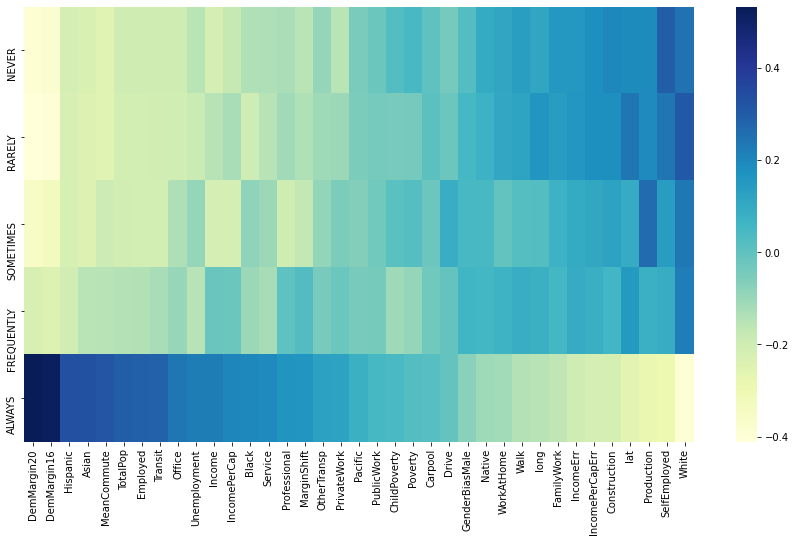

In [52]:
import seaborn as sn
import matplotlib.pyplot as plt

plt.figure(figsize=(15,8))
sn.heatmap(corr_df.sort_values('ALWAYS',axis=1,ascending=False), cmap="YlGnBu") #, annot=True)
plt.savefig('heatmap.png')

In [53]:
X_train, X_test, y_train, y_test = train_test_split(scaled_df, mask_use, test_size=1/3,random_state=1)
etr = ExtraTreesRegressor(n_estimators=200,n_jobs=-1).fit(X_train,y_train)
full_predict = pd.DataFrame(etr.predict(scaled_df))
full_predict.columns = mask_use.columns
full_predict.index = mask_use.index
full_predict

,NEVER,RARELY,SOMETIMES,FREQUENTLY,ALWAYS
fips,,,,,
1001.0,0.053000,0.074000,0.134000,0.295000,0.444000
1003.0,0.083000,0.059000,0.098000,0.323000,0.436000
1005.0,0.067000,0.121000,0.120000,0.201000,0.491000
1007.0,0.096075,0.105675,0.135720,0.201175,0.461310
1009.0,0.112135,0.086885,0.165075,0.206880,0.428960
...,...,...,...,...,...
56037.0,0.096620,0.106805,0.143760,0.250770,0.402090
56039.0,0.041220,0.042100,0.066275,0.208435,0.641835
56041.0,0.114605,0.125135,0.137680,0.249775,0.372865


In [54]:
error_df =  full_predict - mask_use
error_df.reset_index(inplace=True)
error_df

,fips,NEVER,RARELY,SOMETIMES,FREQUENTLY,ALWAYS
0,1001.0,1.665335e-16,-1.249001e-16,2.498002e-16,1.221245e-15,1.554312e-15
1,1003.0,9.714451e-17,-1.595946e-16,6.938894e-17,3.885781e-16,1.887379e-15
2,1005.0,1.249001e-16,-2.359224e-16,1.110223e-16,3.608225e-16,-2.775558e-16
3,1007.0,7.607500e-02,7.167500e-02,3.972000e-02,-7.682500e-02,-1.106900e-01
4,1009.0,5.913500e-02,-2.711500e-02,-1.492500e-02,1.288000e-02,-3.004000e-02
...,...,...,...,...,...,...
3036,56037.0,3.562000e-02,-1.881950e-01,-8.624000e-02,1.047700e-01,1.340900e-01
3037,56039.0,-5.378000e-02,-1.149000e-01,-9.372500e-02,-3.856500e-02,3.018350e-01
3038,56041.0,1.660500e-02,-1.528650e-01,-1.632000e-02,4.277500e-02,1.088650e-01
3039,56043.0,4.996004e-16,4.163336e-16,3.330669e-16,-1.387779e-15,-5.551115e-16


In [55]:
MSE = (error_df**2).drop('fips',axis=1).mean().sort_values(ascending=False)
print(MSE)
print()
print(1/(MSE/MSE['ALWAYS']))

ALWAYS        0.002267
FREQUENTLY    0.000983
SOMETIMES     0.000822
RARELY        0.000646
NEVER         0.000620
dtype: float64

ALWAYS        1.000000
FREQUENTLY    2.306974
SOMETIMES     2.759214
RARELY        3.509024
NEVER         3.653421
dtype: float64


In [56]:
MSE**.5

ALWAYS        0.047610
FREQUENTLY    0.031346
SOMETIMES     0.028662
RARELY        0.025416
NEVER         0.024909
dtype: float64

In [57]:
import altair as alt
alt.data_transformers.enable('default', max_rows=None)
alt.Chart(error_df.drop('fips',axis=1).melt()).mark_boxplot().encode(
    alt.X('variable', title="Mask Use Frequency"),
    alt.Y('value', title="Average Error By county")
).properties(
    title = 'AverageError',
    width = 400,
    height = 400
)

alt.Chart(...)

In [58]:
counties = alt.topo_feature(data.us_10m.url, 'counties')
plots = []
for var in error_df.columns[:0:-1]:
    plots.append(
        alt.Chart(counties).mark_geoshape(  
            stroke='black',
            strokeWidth=0.05
        ).project(
          type='albersUsa'
        ).transform_lookup(
            lookup='id',
            from_=alt.LookupData(error_df,'fips',[var])
        ).encode(
            color=alt.Color(var+':Q',scale=alt.Scale(scheme='redblue'),title="Error")
        ).properties(
            title=var
        )
    )
alt.hconcat(*plots)

alt.HConcatChart(...)

In [59]:
error_corrs = pd.DataFrame()
for var in error_df.columns[1:]:
    high_error_counties = error_df[[var,'fips']].sort_values(var,ascending=False, key=abs).head(50)
    high_error_counties = state_county_fips.merge(high_error_counties)
    high_error_counties = high_error_counties.merge(county_data_merged.reset_index()).set_index(['state', 'county']).drop('fips',axis=1)
    error_corr = high_error_counties.corr()
    error_corr = error_corr.drop(error_corr.columns[1:], axis=1).iloc[1:]
    error_corrs[var] = error_corr[var]
for var in error_corrs.columns:
    print(error_corrs[var].sort_values(ascending=False,key=abs).head(10),end='\n\n')

Unemployment      0.252303
PublicWork        0.240594
PrivateWork      -0.226333
ChildPoverty     -0.205781
GenderBiasMale    0.200967
Asian             0.199067
Professional      0.177857
Income            0.168023
WorkAtHome        0.161371
Black             0.156542
Name: NEVER, dtype: float64

PrivateWork    -0.446274
PublicWork      0.441437
Native          0.431633
Walk            0.425280
Office         -0.378038
Construction    0.350428
IncomePerCap   -0.304678
White          -0.264102
IncomeErr       0.262248
Poverty         0.258356
Name: RARELY, dtype: float64

Pacific           0.237048
OtherTransp       0.225001
FamilyWork        0.202329
Walk              0.192319
Production        0.188466
DemMargin20      -0.173074
DemMargin16      -0.159759
GenderBiasMale   -0.150642
Office           -0.143189
Transit          -0.129103
Name: SOMETIMES, dtype: float64

Unemployment   -0.262721
PrivateWork     0.248330
PublicWork     -0.243698
Office         -0.201169
Production      0.

In [60]:
error_melt = error_df.melt(id_vars='fips',var_name='column',value_name='Error').merge(state_county_fips).sort_values('Error',ascending=False,key=abs).set_index(['state','county','fips'])
error_melt.head(50)

column     Error
state county       fips                         
NV    Esmeralda    32009.0      ALWAYS -0.424605
KY    Harrison     21097.0      ALWAYS -0.369460
ID    Teton        16081.0      ALWAYS  0.366180
      Boise        16015.0  FREQUENTLY -0.333015
WY    Teton        56039.0      ALWAYS  0.301835
NE    York         31185.0   SOMETIMES -0.272045
OK    Custer       40039.0   SOMETIMES -0.269580
WA    Lincoln      53043.0      ALWAYS -0.267175
IA    Cerro Gordo  19033.0      RARELY -0.258470
OK    Custer       40039.0      ALWAYS  0.256840
IA    Hancock      19081.0      RARELY -0.247585
NY    Wyoming      36121.0      ALWAYS -0.239995
OR    Malheur      41045.0      ALWAYS  0.234895
KY    Scott        21209.0      ALWAYS -0.231040
CO    Saguache     8109.0       ALWAYS  0.230985
WI    Richland     55103.0       NEVER -0.230790
GA    Lee          13177.0      ALWAYS -0.230015
ID    Washington   16087.0      ALWAYS  0.229765
      Adams        16003.0      ALWAYS  0.228680
MS    Neshoba      28099.0      ALWAYS -0.228655
IA    Cass         19029.0       NEVER -0.225655
IL    Stark        17175.0      ALWAYS -0.224650
TX    Palo Pinto   48363.0      ALWAYS -0.223145
NV    Pershing     32027.0      ALWAYS -0.222240
UT    Duchesne     49013.0  FREQUENTLY -0.220605
NE    York         31185.0      ALWAYS  0.213950
TX    Jasper       48241.0      ALWAYS -0.209935
IN    Pulaski      18131.0      ALWAYS  0.209680
IA    Cerro Gordo  19033.0      ALWAYS  0.209410
TN    Bedford      47003.0      ALWAYS  0.204485
OK    Kingfisher   40073.0      ALWAYS -0.204395
NY    Yates        36123.0      ALWAYS -0.203700
WI    Shawano      55115.0   SOMETIMES -0.203380
IL    Wabash       17185.0      ALWAYS  0.198985
UT    Juab         49023.0       NEVER -0.196280
KY    Harrison     21097.0  FREQUENTLY  0.194820
LA    West Carroll 22123.0      ALWAYS -0.194675
ID    Washington   16087.0   SOMETIMES -0.194190
NV    Esmeralda    32009.0  FREQUENTLY  0.193820
WY    Sweetwater   56037.0      RARELY -0.188195
TX    Falls        48145.0      ALWAYS -0.185835
NV    White Pine   32033.0  FREQUENTLY -0.185320
      Pershing     32027.0  FREQUENTLY  0.184120
OR    Morrow       41049.0      ALWAYS -0.184015
UT    Uintah       49047.0      ALWAYS  0.182735
ID    Shoshone     16079.0   SOMETIMES -0.181510
GA    Dade         13083.0      ALWAYS  0.180115
IL    Fulton       17057.0   SOMETIMES -0.178610
OH    Coshocton    39031.0      ALWAYS  0.178315
IL    Piatt        17147.0      ALWAYS -0.178065

In [61]:
lookup = error_melt.reset_index().tail(10)
lookup

,state,county,fips,column,Error
15195,IN,Grant,18053.0,FREQUENTLY,0.0
15196,AZ,Maricopa,4013.0,NEVER,0.0
15197,MT,Fergus,30027.0,SOMETIMES,0.0
15198,IN,Henry,18065.0,SOMETIMES,0.0
15199,TX,Karnes,48255.0,NEVER,0.0
15200,TX,Karnes,48255.0,ALWAYS,0.0
15201,MO,Warren,29219.0,FREQUENTLY,0.0
15202,GA,Butts,13035.0,NEVER,0.0
15203,MO,Ste. Genevieve,29186.0,FREQUENTLY,0.0
15204,GA,Haralson,13143.0,NEVER,0.0


In [62]:
print(full_predict.loc[12086.0])
print()
print(mask_use.loc[12086.0])

NEVER         0.032
RARELY        0.023
SOMETIMES     0.060
FREQUENTLY    0.128
ALWAYS        0.756
Name: 12086.0, dtype: float64

NEVER         0.032
RARELY        0.023
SOMETIMES     0.060
FREQUENTLY    0.128
ALWAYS        0.756
Name: 12086.0, dtype: float64


In [63]:
print(full_predict.loc[32009.0])
print()
print(mask_use.loc[32009.0])

NEVER         0.089810
RARELY        0.100895
SOMETIMES     0.136075
FREQUENTLY    0.225820
ALWAYS        0.447395
Name: 32009.0, dtype: float64

NEVER         0.086
RARELY        0.004
SOMETIMES     0.006
FREQUENTLY    0.032
ALWAYS        0.872
Name: 32009.0, dtype: float64


In [64]:
error_sums = abs(error_melt['Error'])
error_sums = error_sums.groupby(['state','county','fips']).sum().sort_values(ascending=False)
error_sums.head(10)

state  county     fips   
OK     Custer     40039.0    0.871355
NV     Esmeralda  32009.0    0.849205
KY     Harrison   21097.0    0.739920
ID     Teton      16081.0    0.732630
UT     Duchesne   49013.0    0.714310
NV     Pershing   32027.0    0.695805
NE     York       31185.0    0.673105
ID     Boise      16015.0    0.665965
WY     Teton      56039.0    0.602805
UT     Uintah     49047.0    0.588160
Name: Error, dtype: float64

In [65]:
error_sums.tail(10)

state  county       fips   
WA     King         53033.0    4.753142e-16
IL     DeKalb       17037.0    4.640385e-16
VA     Caroline     51033.0    4.614364e-16
NM     Socorro      35053.0    4.575333e-16
SC     Lee          45061.0    4.302114e-16
TX     Trinity      48455.0    4.302114e-16
CO     Grand        8049.0     4.289104e-16
FL     Miami-Dade   12086.0    3.816392e-16
VA     Arlington    51013.0    2.393918e-16
NY     Schenectady  36093.0    2.333203e-16
Name: Error, dtype: float64

In [66]:
counts = pd.Series(np.zeros(len(scaled_df_columns)))
counts.index = scaled_df_columns
for county in error_sums.reset_index()['fips'].loc[:50]:
  z_scores = scaled_df.loc[county].sort_values(ascending=False,key=abs)
  z_scores = z_scores.loc[abs(z_scores) >= 2]
  for col in z_scores.index:
      counts.loc[col] += 1
print(counts.loc[counts > 2].sort_values(ascending=False))

GenderBiasMale    4.0
Walk              4.0
IncomeErr         4.0
PrivateWork       3.0
WorkAtHome        3.0
OtherTransp       3.0
Construction      3.0
dtype: float64


In [67]:
always_error = error_df.set_index('fips')['ALWAYS']
always_error

fips
1001.0     1.554312e-15
1003.0     1.887379e-15
1005.0    -2.775558e-16
1007.0    -1.106900e-01
1009.0    -3.004000e-02
               ...     
56037.0    1.340900e-01
56039.0    3.018350e-01
56041.0    1.088650e-01
56043.0   -5.551115e-16
56045.0   -3.702500e-02
Name: ALWAYS, Length: 3041, dtype: float64

In [68]:
cv_errs = -cross_val_score(RandomForestRegressor(), X=scaled_df, y=always_error, scoring="explained_variance", cv=5) 
cv_errs.mean() 

0.05715793584905704

In [69]:
for var in error_df.columns[1:]:
    error = error_df[var]
    rfr_error = RandomForestRegressor().fit(scaled_df, error)
    rfr_importance_df = pd.DataFrame(rfr_error.feature_importances_)
    rfr_importance_df.columns = ['importance_' + var]
    rfr_importance_df['column'] = scaled_df.columns
    rfr_importance_df.sort_values('importance_' + var,ascending=False,inplace=True)
    print(rfr_importance_df.head())
    print()

    importance_NEVER           column
26          0.042408      MeanCommute
19          0.037479       Production
12          0.037047  IncomePerCapErr
36          0.035173   GenderBiasMale
1           0.034970             long

    importance_RARELY           column
1            0.050599             long
36           0.042723   GenderBiasMale
0            0.042443              lat
25           0.037098       WorkAtHome
12           0.034303  IncomePerCapErr

    importance_SOMETIMES          column
26              0.047350     MeanCommute
10              0.041900       IncomeErr
36              0.040849  GenderBiasMale
17              0.038067          Office
1               0.037763            long

    importance_FREQUENTLY          column
26               0.046816     MeanCommute
36               0.044667  GenderBiasMale
17               0.038333          Office
0                0.037337             lat
1                0.035042            long

    importance_ALWAYS          colum

In [70]:
rfr_error = RandomForestRegressor().fit(scaled_df, error_df)
rfr_importance_df = pd.DataFrame(rfr_error.feature_importances_)
rfr_importance_df.columns = ['importance_OVERALL']
rfr_importance_df['column'] = scaled_df.columns
rfr_importance_df.sort_values('importance_OVERALL',ascending=False,inplace=True)
print(rfr_importance_df)

    importance_OVERALL           column
1             0.484492             long
0             0.356610              lat
33            0.018548      DemMargin20
35            0.015200      MarginShift
6             0.008909           Native
34            0.008248      DemMargin16
3             0.008041         Hispanic
30            0.007192     SelfEmployed
10            0.006979        IncomeErr
11            0.006314     IncomePerCap
26            0.004757      MeanCommute
2             0.004614         TotalPop
32            0.004332     Unemployment
29            0.004212       PublicWork
16            0.004115          Service
27            0.003942         Employed
9             0.003795           Income
12            0.003696  IncomePerCapErr
4             0.003539            White
19            0.003471       Production
17            0.003361           Office
20            0.003185            Drive
5             0.003047            Black
23            0.002943             Walk
